# 1. Dimensionality reduction

In [2]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler

In [3]:
df = pd.read_csv('weatherHistory_v1.csv')
df = df.drop('Loud Cover',axis=1)
df = df.replace('?', np.NaN)
df = df.dropna()
df['Wind Speed (km/h)'] = pd.Categorical(df['Wind Speed (km/h)'])

### Only on continuous features

In [8]:
num_df = df.select_dtypes(include='float64').copy()
num_df['y'] = df['Wind Speed (km/h)'].cat.codes

In [9]:
for column in num_df.columns:
    scale = StandardScaler().fit(num_df[[column]])
    num_df[[column]] = scale.transform(num_df[[column]])

## PCA

In [10]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(num_df.values)
num_df['pca1'] = pca_result[:,0]
num_df['pca2'] = pca_result[:,1] 
num_df['pca3'] = pca_result[:,2]

<AxesSubplot:xlabel='pca1', ylabel='pca2'>

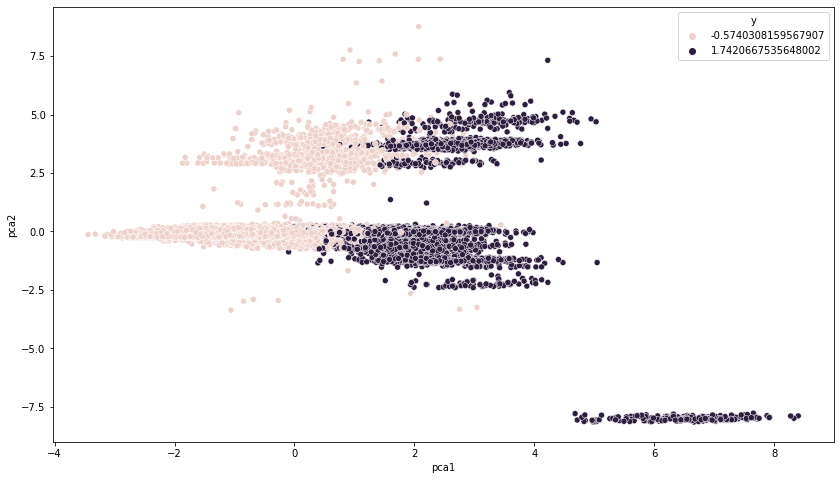

In [6]:
plt.figure(figsize=(14,8))
sns.scatterplot(
    x="pca1", y="pca2",
    hue="y",
    data=num_df,
    legend="full")

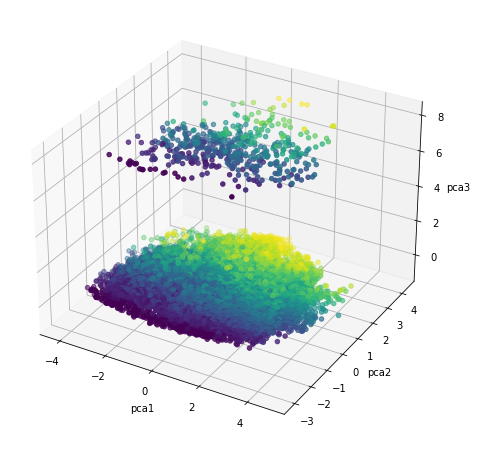

In [11]:
ax = plt.figure(figsize=(14,8)).gca(projection='3d')
ax.scatter(
    xs=num_df["pca1"], 
    ys=num_df["pca2"], 
    zs=num_df["pca3"], 
    c=num_df["y"]
)
ax.set_xlabel('pca1')
ax.set_ylabel('pca2')
ax.set_zlabel('pca3')
plt.show()

## t-SNE

In [12]:
tsne = TSNE(n_components=2, perplexity=40, n_iter=500)
tsne_results = tsne.fit_transform(num_df)

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

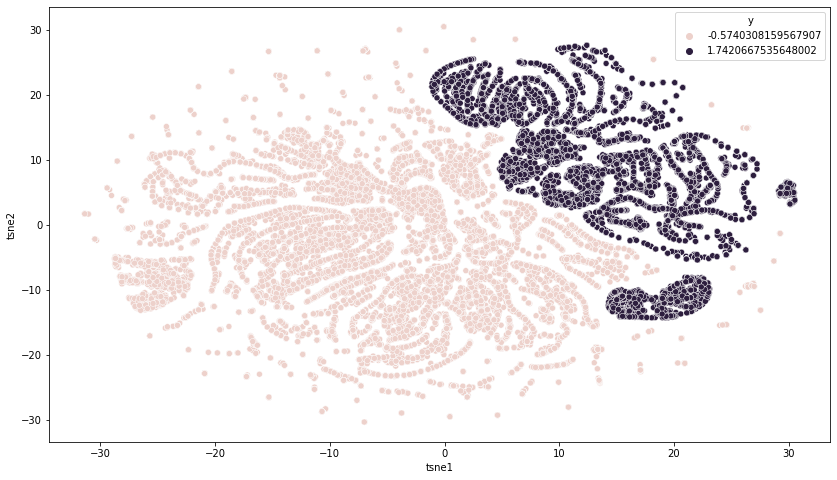

In [9]:
num_df['tsne1'] = tsne_results[:,0]
num_df['tsne2'] = tsne_results[:,1]
plt.figure(figsize=(14,8))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="y",
    data=num_df,
    legend="full",
)

# 2. Clustering

## 1) Image quantization

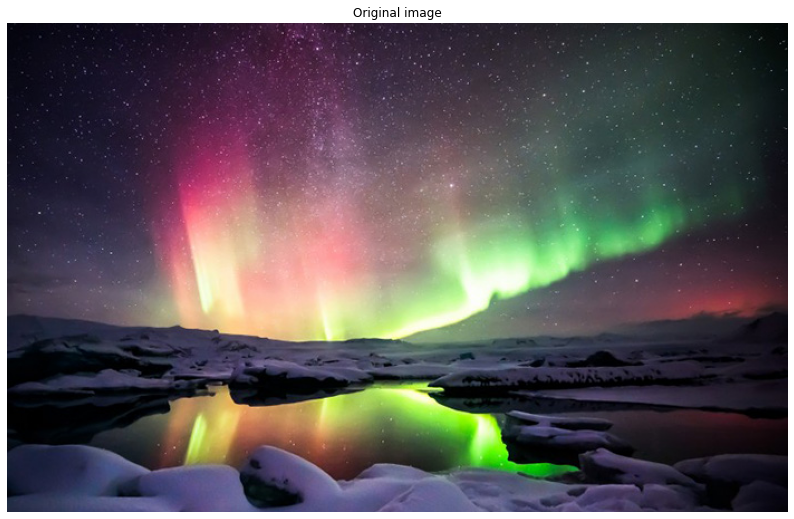

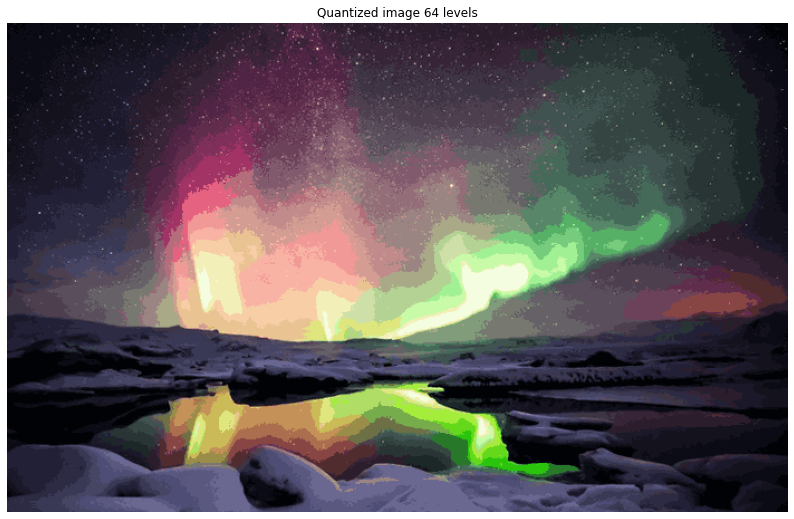

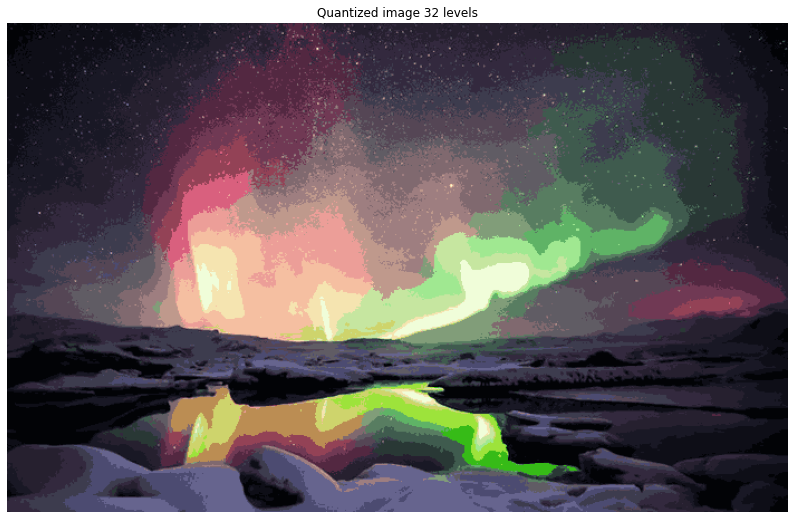

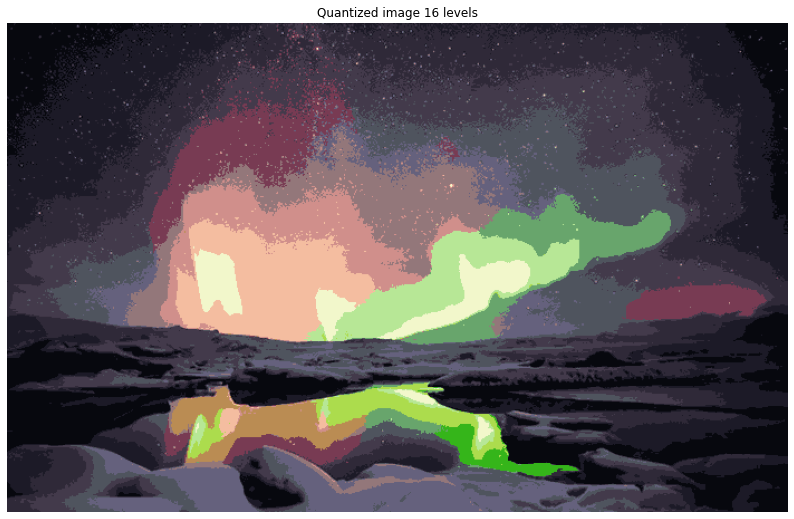

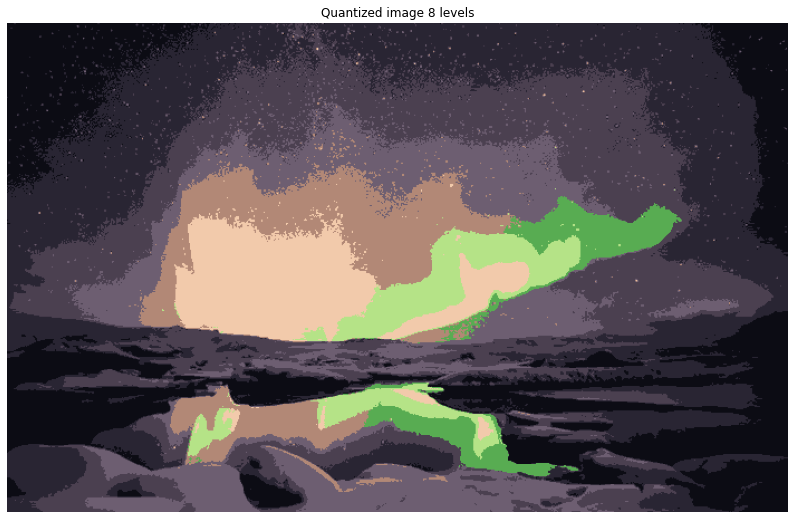

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.cluster import KMeans


def recreate_image(codebook, labels, w, h):
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image


N_COLORS = [64, 32, 16, 8]
SUBSAMPLE_SIZE = 0.01

image = Image.open('img.jpg')
image = np.array(image, dtype=np.float64) / 255

w, h, d = tuple(image.shape)
image_array = np.reshape(image, (w * h, d))
img_subsample = image_array[np.random.choice(w * h, int(w * h * SUBSAMPLE_SIZE)), :]

models = []
for colors in N_COLORS:
    kmeans = KMeans(n_clusters=colors).fit(img_subsample)
    models.append(kmeans)
    
plt.figure(figsize=(16,9))
plt.axis('off')
plt.title('Original image')
plt.imshow(image) 

for model in models:
    labels = model.predict(image_array)
    plt.figure(figsize=(16,9))
    plt.clf()
    plt.axis('off')
    plt.title(f'Quantized image {model.get_params().get("n_clusters")} levels')
    plt.imshow(recreate_image(model.cluster_centers_, labels, w, h))

## 2) Silhouette analysis

For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.5745566973301872
For n_clusters = 6 The average silhouette_score is : 0.4387644975296138


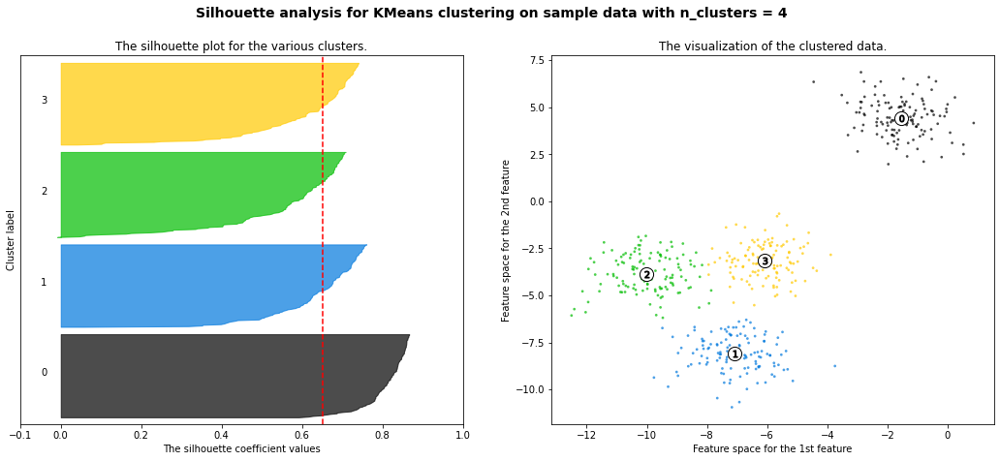

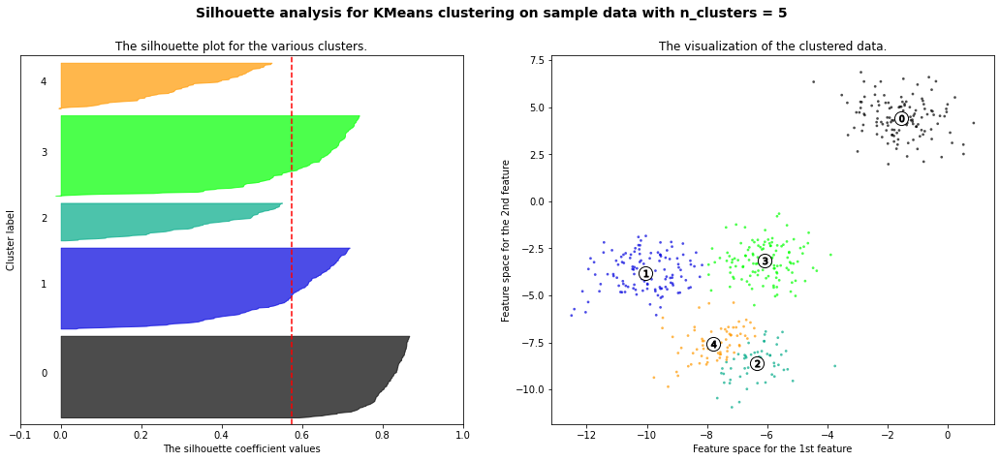

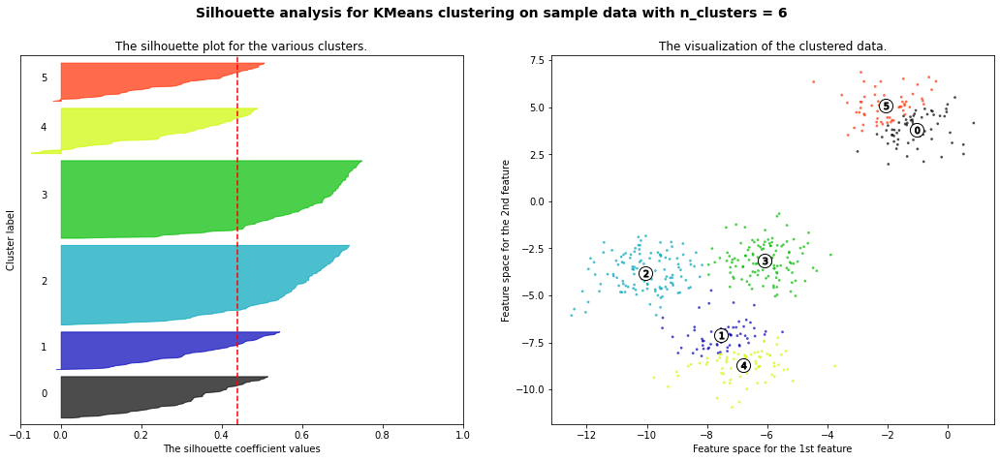

In [14]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np


X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  shuffle=True,
                  random_state=1)

range_n_clusters = [4, 5, 6]

for n_clusters in range_n_clusters:
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
    
    ax1.set_xlim([-0.1, 1])
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])


    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

silhouette plot показывает насколько точки кластера ближе к точкам своего кластера чем к точкам другого ближайшего кластера, дополнительно так же показывает размер самого кластера. В данном случае видно что в данных скорее всего не 6 кластеров, так как есть кластер с silhouette coefficient меньше среднего по всем данным, более того, кластеры сильно отличаются по размерам. Варианты 4 и 5 выглядят одинаково приемлимо, так как в кластерах примерно одинаковой формы графики распределения silhouette coefficient. 5 кластеров выигрывают только тем, что имеют одинаковый размер кластеров, что, впрочем, может и не быть правдой в прикладных задачах.

## 3) EM-algorithm

In [15]:
from sklearn.mixture import GaussianMixture
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [16]:
mean1 = [6, 6]
cov1 = [[9, 1],
        [1, 9]]

mean2 = [10, 10]
cov2 = [[12, 0],
        [0, 12]]


x1 = np.random.default_rng().multivariate_normal(mean1, cov1, 1000)
x2 = np.random.default_rng().multivariate_normal(mean2, cov2, 1000)
df = np.vstack([x1,x2])

In [17]:
gm = GaussianMixture(n_components=2, covariance_type='diag')
labels = gm.fit_predict(df)

<AxesSubplot:>

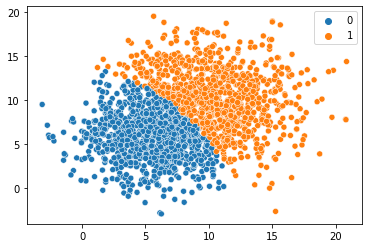

In [18]:
sns.scatterplot(x=df[:,0], y=df[:,1], hue=labels)

### Recreating distributions

In [19]:
gm.covariances_[0]

array([8.23763591, 8.66912845])

In [20]:
x1 = np.random.default_rng().multivariate_normal(gm.means_[0], np.diag(gm.covariances_[0]), 1000)
x2 = np.random.default_rng().multivariate_normal(gm.means_[1], np.diag(gm.covariances_[1]), 1000)
df = np.vstack([x1,x2])

<AxesSubplot:>

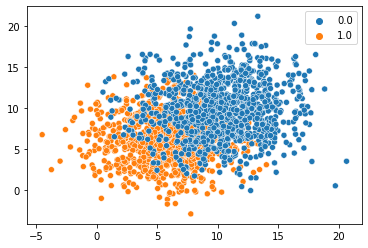

In [21]:
sns.scatterplot(x=df[:,0], y=df[:,1], hue=np.hstack([np.ones((1000)),np.zeros((1000))]))

# 3. NLP

In [98]:
import string
import pandas as pd
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from wordcloud import WordCloud

from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB

pd.set_option('max_colwidth', 400)


In [99]:
corpus = pd.read_csv('Sheet.csv')
corpus = corpus.replace('not_flagged', '0')
corpus = corpus.replace('flagged', '1')
corpus = corpus.replace(np.NaN, '2')

## 1) Data cleaning

In [100]:
corpus

,response_id,class,response_text
0,response_1,0,I try and avoid this sort of conflict
1,response_2,1,Had a friend open up to me about his mental addiction to weed and how it was taking over his life and making him depressed
2,"response_3,flagged,""I saved a girl from suicide once. She was going to swallow a bunch of pills and I talked her out of it in a very calm, loving way.""",2,2
3,response_4,0,i cant think of one really...i think i may have indirectly
4,"response_5,not_flagged,""Only really one friend who doesn't fit into the any of the above categories. Her therapist calls it spiraling."""" Anyway she pretty much calls me any time she is frustrated by something with her boyfriend to ask me if it's logical or not. Before they would just fight and he would call her crazy. Now she asks me if it's ok he didn't say """"please"""" when he said """"hand me...",2,2
...,...,...,...
75,"response_76,not_flagged,""Now that I've been through it, although i'm not even where I'd like to be, I'm extremely open about sharing my experience with others and helping friends going through similar situations. And PLEASE if you have any other questions about my situation don't hesitate to email me. I'm an open book and excited to see how many people you're going to help.""",2,2
76,response_77,1,when my best friends mom past away from od'ing when he was in grade 5
77,response_78,0,As a camp counselor I provide stability in kids lives who may have troubled home situations.
78,response_79,1,My now girlfriend used to have serious addiction troubles before we started dating and felt as though her addiction defined her as a person. She thought that all people saw when they looked at her was the addiction. I spent many nights with her talking and letting her vent. I was one of the only people supporting her and she felt as though I could help because I had been in her spot.


Lowercase and leading/trailing whitespaces

In [101]:
corpus['response_text'] = corpus['response_text'].str.lower()
corpus['response_text'] = corpus['response_text'].str.strip()

Replace numbers with tokens

In [102]:
corpus['response_text'] = corpus['response_text'].str.replace('\d+','NUMBER', regex=True)

Removing stop-words

In [103]:
stop_words = stopwords.words('english')

In [104]:
corpus['response_text'] = corpus['response_text'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))

Removing punctuation

In [105]:
table = str.maketrans('', '', string.punctuation)
corpus['response_text'] = corpus['response_text'].str.translate(table)

Lemmatization

In [106]:
lemmatizer = WordNetLemmatizer()
corpus['response_text'] = corpus['response_text'].apply(lambda x: ' '.join([lemmatizer.lemmatize(word) for word in x.split()]))

In [107]:
corpus

,response_id,class,response_text
0,response_1,0,try avoid sort conflict
1,response_2,1,friend open mental addiction weed taking life making depressed
2,"response_3,flagged,""I saved a girl from suicide once. She was going to swallow a bunch of pills and I talked her out of it in a very calm, loving way.""",2,NUMBER
3,response_4,0,cant think one reallyi think may indirectly
4,"response_5,not_flagged,""Only really one friend who doesn't fit into the any of the above categories. Her therapist calls it spiraling."""" Anyway she pretty much calls me any time she is frustrated by something with her boyfriend to ask me if it's logical or not. Before they would just fight and he would call her crazy. Now she asks me if it's ok he didn't say """"please"""" when he said """"hand me...",2,NUMBER
...,...,...,...
75,"response_76,not_flagged,""Now that I've been through it, although i'm not even where I'd like to be, I'm extremely open about sharing my experience with others and helping friends going through similar situations. And PLEASE if you have any other questions about my situation don't hesitate to email me. I'm an open book and excited to see how many people you're going to help.""",2,NUMBER
76,response_77,1,best friend mom past away oding grade NUMBER
77,response_78,0,camp counselor provide stability kid life may troubled home situation
78,response_79,1,girlfriend used serious addiction trouble started dating felt though addiction defined person thought people saw looked addiction spent many night talking letting vent one people supporting felt though could help spot


## 2) Visualization

In [108]:
def generate_word_cloud(text):
    wordcloud = WordCloud(
        width = 3000,
        height = 2000,
        background_color = 'black').generate(str(text))
    fig = plt.figure(
        figsize = (40, 30),
        facecolor = 'k',
        edgecolor = 'k')
    plt.imshow(wordcloud, interpolation = 'bilinear')
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()

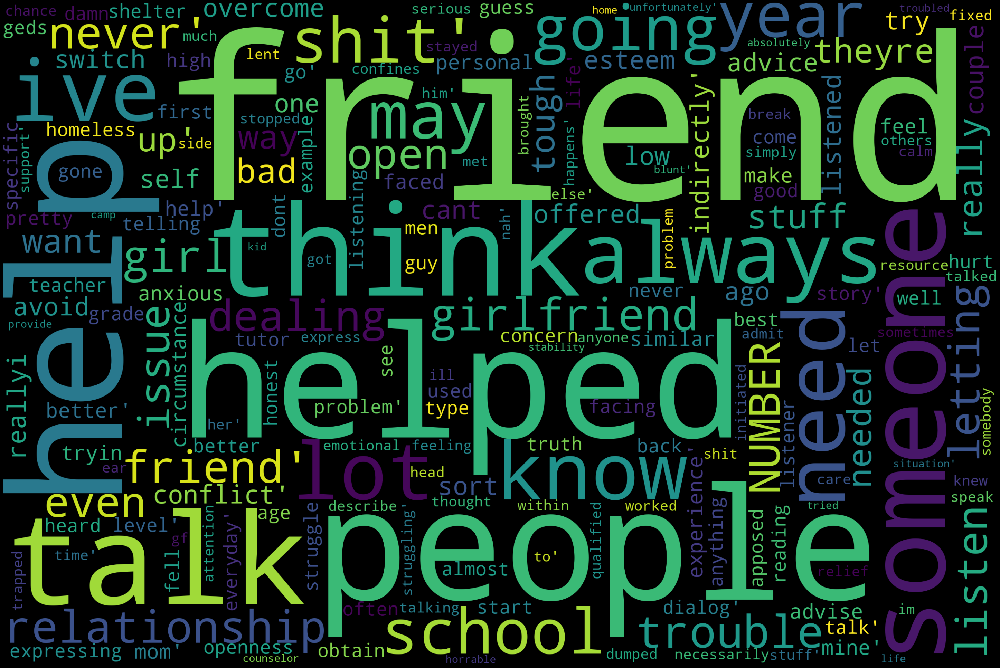

In [109]:
generate_word_cloud(corpus[corpus['class']=='0'].response_text.values)

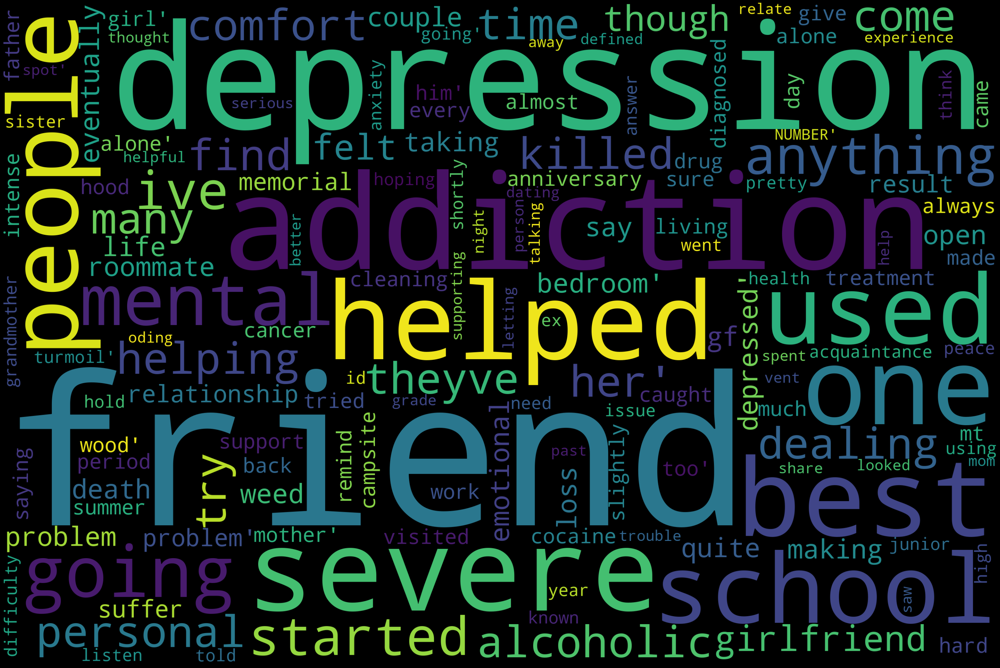

In [110]:
generate_word_cloud(corpus[corpus['class']=='1'].response_text.values)

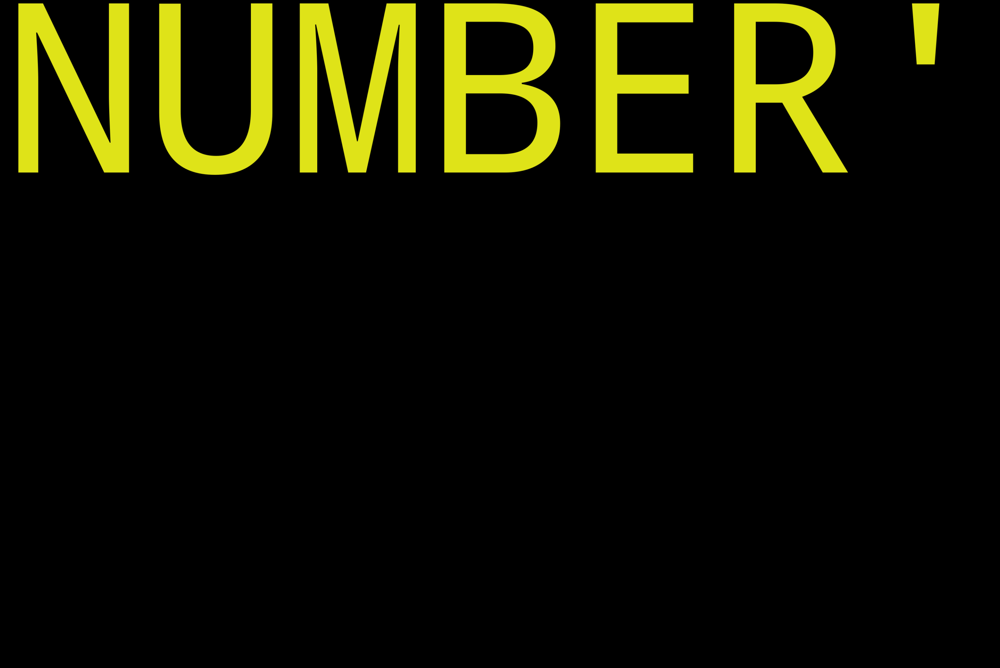

In [111]:
generate_word_cloud(corpus[corpus['class']=='2'].response_text.values)

## 3) Feature extraction

In [112]:
X = TfidfVectorizer(max_features=8000).fit_transform(corpus['response_text'])
y = corpus['class']

## 4) Classification

In [113]:
X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = MultinomialNB().fit(X_train, y_train)
prediction = model.predict(X_test)
print("accuracy: {}%".format(round(accuracy_score(y_test, prediction)*100,2)))

accuracy: 75.0%
